In [10]:
import json
import os
from pathlib import Path
import folium
from folium import GeoJson
from folium import plugins
import pandas as pd

# Configuration
STRAITS_FOLDER = "/home/crimsondeepdarshak/Desktop/Deep_Darshak/References/Build_1_docs/Straits_polygon/Straits_boundaries"

def load_straits_data(folder_path):
    """
    Load all JSON files from the straits folder.
    Returns a list of dictionaries containing strait data.
    """
    straits_data = []
    folder = Path(folder_path)
    
    
    if not folder.exists():
        raise FileNotFoundError(f"Folder not found: {folder_path}")
    
    json_files = list(folder.glob("*.json"))
    
    if not json_files:
        raise FileNotFoundError(f"No JSON files found in {folder_path}")
    
    print(f"Found {len(json_files)} JSON files")
    
    for json_file in json_files:
        try:
            with open(json_file, 'r', encoding='utf-8') as f:
                data = json.load(f)
                straits_data.append({
                    'filename': json_file.name,
                    'strait_name': json_file.stem.replace('_', ' ').title(),
                    'data': data
                })
                print(f"✓ Loaded: {json_file.name}")
        except Exception as e:
            print(f"✗ Error loading {json_file.name}: {e}")
    
    return straits_data

def create_straits_map(straits_data, center=None, zoom=2):
    """
    Create an interactive Folium map with all straits.
    
    Parameters:
    - straits_data: List of strait dictionaries
    - center: [lat, lon] for map center (None = auto-calculate)
    - zoom: Initial zoom level
    """
    # Auto-calculate center if not provided
    if center is None:
        center = [20, 0]  # Default world view
    
    # Create base map
    m = folium.Map(
        location=center,
        zoom_start=zoom,
        tiles='OpenStreetMap'
    )
    
    # Add additional tile layers
    folium.TileLayer('CartoDB positron', name='Light Mode').add_to(m)
    folium.TileLayer('CartoDB dark_matter', name='Dark Mode').add_to(m)
    
    # Color palette for different straits
    colors = ['red', 'blue', 'green', 'purple', 'orange', 'darkred', 
              'lightred', 'beige', 'darkblue', 'darkgreen', 'cadetblue', 
              'darkpurple', 'pink', 'lightblue', 'lightgreen', 'gray', 
              'black', 'lightgray']
    
    # Create a feature group for each strait
    for idx, strait in enumerate(straits_data):
        color = colors[idx % len(colors)]
        strait_name = strait['strait_name']
        
        # Create feature group for this strait
        fg = folium.FeatureGroup(name=strait_name, show=True)
        
        # Add GeoJson to the feature group
        geojson = GeoJson(
            strait['data'],
            name=strait_name,
            style_function=lambda x, color=color: {
                'fillColor': color,
                'color': color,
                'weight': 2,
                'fillOpacity': 0.4
            },
            highlight_function=lambda x: {
                'weight': 4,
                'fillOpacity': 0.7
            },
            tooltip=folium.Tooltip(strait_name)
        )
        
        geojson.add_to(fg)
        fg.add_to(m)
    
    # Add layer control
    folium.LayerControl(collapsed=False).add_to(m)
    
    # Add fullscreen button
    plugins.Fullscreen(
        position='topright',
        title='Fullscreen',
        title_cancel='Exit Fullscreen',
        force_separate_button=True
    ).add_to(m)
    
    # Add measure control
    plugins.MeasureControl(
        position='topleft',
        primary_length_unit='kilometers',
        secondary_length_unit='miles'
    ).add_to(m)
    
    # Add minimap
    plugins.MiniMap(toggle_display=True).add_to(m)
    
    return m

def get_straits_summary(straits_data):
    """Generate a summary dataframe of loaded straits."""
    summary = []
    for strait in straits_data:
        data = strait['data']
        feature_count = len(data.get('features', [])) if 'features' in data else 1
        summary.append({
            'Strait Name': strait['strait_name'],
            'Filename': strait['filename'],
            'Features': feature_count,
            'Type': data.get('type', 'N/A')
        })
    return pd.DataFrame(summary)

# Main execution
try:
    # Load straits data
    print("Loading straits data...")
    straits = load_straits_data(STRAITS_FOLDER)
    
    # Display summary
    print("\n" + "="*60)
    print("STRAITS DATA SUMMARY")
    print("="*60)
    summary_df = get_straits_summary(straits)
    display(summary_df)
    
    # Create and display map
    print("\nCreating interactive map...")
    straits_map = create_straits_map(straits)
    
    print("\n✓ Map created successfully!")
    print("\nFeatures:")
    print("- Toggle layers on/off using the layer control (top right)")
    print("- Hover over straits to see names")
    print("- Click and drag to pan, scroll to zoom")
    print("- Use measure tool to calculate distances")
    print("- Switch between different map styles")
    
    # Display the map
    display(straits_map)
    
    # Optional: Save map to HTML file
    output_file = "straits_world_map.html"
    straits_map.save(output_file)
    print(f"\n✓ Map also saved to: {output_file}")

except Exception as e:
    print(f"\n✗ Error: {e}")
    import traceback
    traceback.print_exc()

Loading straits data...
Found 22 JSON files
✓ Loaded: bab_el_mandeb_manual.json
✓ Loaded: Bering.json
✓ Loaded: Bering_strait.json
✓ Loaded: Starit_of_Gibraltar.json
✓ Loaded: Lombok_strait_bounding_box.json
✓ Loaded: bab_el_mandeb.json
✓ Loaded: Lombok_strait_manual.json
✓ Loaded: Davis_strait.json
✓ Loaded: starit_of_hormuz.json
✓ Loaded: cook_strait.json
✓ Loaded: Sundra_strait_boundix_box.json
✓ Loaded: Sundra_strait_manual.json
✓ Loaded: Malacca_.json
✓ Loaded: Denmark_strait.json
✓ Loaded: gulf_of_aden.json
✓ Loaded: Mozambique_Channel.json
✓ Loaded: Palk_strait_bounding_box.json
✓ Loaded: Palk_strait.json
✓ Loaded: Palk_strait_manual.json
✓ Loaded: red_sea.json
✓ Loaded: Makassar_Strait.json
✓ Loaded: Bass_Strait.json

STRAITS DATA SUMMARY


,Strait Name,Filename,Features,Type
0,Bab El Mandeb Manual,bab_el_mandeb_manual.json,1,FeatureCollection
1,Bering,Bering.json,1,FeatureCollection
2,Bering Strait,Bering_strait.json,1,FeatureCollection
3,Starit Of Gibraltar,Starit_of_Gibraltar.json,1,FeatureCollection
4,Lombok Strait Bounding Box,Lombok_strait_bounding_box.json,1,FeatureCollection
5,Bab El Mandeb,bab_el_mandeb.json,1,FeatureCollection
6,Lombok Strait Manual,Lombok_strait_manual.json,1,FeatureCollection
7,Davis Strait,Davis_strait.json,1,FeatureCollection
8,Starit Of Hormuz,starit_of_hormuz.json,1,FeatureCollection
9,Cook Strait,cook_strait.json,1,FeatureCollection



Creating interactive map...

✓ Map created successfully!

Features:
- Toggle layers on/off using the layer control (top right)
- Hover over straits to see names
- Click and drag to pan, scroll to zoom
- Use measure tool to calculate distances
- Switch between different map styles



✓ Map also saved to: straits_world_map.html


In [11]:
"""
Unified Polygon Viewer - Visualizes both existing straits and custom polygons
with automatic zoom level management and navigation
"""

import json
from pathlib import Path
import folium
from folium import GeoJson, plugins
import pandas as pd
from typing import List, Dict, Optional, Tuple


class UnifiedPolygonViewer:
    """
    Comprehensive viewer for managing and visualizing all polygon data
    with intelligent zoom level handling and navigation features.
    """
    
    def __init__(self, folders: List[str], center: Optional[List] = None, zoom: int = 2):
        """
        Initialize the viewer with multiple polygon folders.
        
        Parameters:
        - folders: List of folder paths containing JSON files
        - center: [lat, lon] for map center (auto-calculated if None)
        - zoom: Initial zoom level
        """
        self.folders = [Path(f) for f in folders]
        self.polygons = []
        self.center = center
        self.zoom = zoom
        
        # Color schemes
        self.colors = [
            '#e74c3c', '#3498db', '#2ecc71', '#f39c12', '#9b59b6',
            '#1abc9c', '#e67e22', '#34495e', '#16a085', '#27ae60',
            '#2980b9', '#8e44ad', '#c0392b', '#d35400', '#7f8c8d'
        ]
        
    def load_all_polygons(self):
        """Load all polygons from specified folders"""
        print("Loading polygons from folders...")
        
        for folder in self.folders:
            if not folder.exists():
                print(f"⚠ Warning: Folder not found: {folder}")
                continue
                
            json_files = list(folder.glob("*.json"))
            
            # Skip metadata files
            json_files = [f for f in json_files if not f.name.startswith('_metadata')]
            
            print(f"\n📁 {folder.name}: Found {len(json_files)} files")
            
            for json_file in json_files:
                try:
                    with open(json_file, 'r', encoding='utf-8') as f:
                        data = json.load(f)
                    
                    # Extract metadata
                    metadata = data.get('metadata', {})
                    
                    polygon_info = {
                        'filename': json_file.name,
                        'name': data.get('name', json_file.stem.replace('_', ' ').title()),
                        'data': data,
                        'folder': folder.name,
                        'center': metadata.get('center'),
                        'recommended_zoom': metadata.get('recommended_zoom'),
                        'created_date': metadata.get('created_date', 'Unknown')
                    }
                    
                    self.polygons.append(polygon_info)
                    print(f"  ✓ {json_file.name}")
                    
                except Exception as e:
                    print(f"  ✗ Error loading {json_file.name}: {e}")
        
        print(f"\n{'='*60}")
        print(f"Total polygons loaded: {len(self.polygons)}")
        print(f"{'='*60}")
        
        return self.polygons
    
    def get_summary_dataframe(self) -> pd.DataFrame:
        """Generate a comprehensive summary DataFrame"""
        if not self.polygons:
            return pd.DataFrame()
            
        summary_data = []
        for poly in self.polygons:
            data = poly['data']
            num_features = len(data.get('features', []))
            
            summary_data.append({
                'Name': poly['name'],
                'Folder': poly['folder'],
                'Features': num_features,
                'Has Center': '✓' if poly['center'] else '✗',
                'Rec. Zoom': poly['recommended_zoom'] if poly['recommended_zoom'] else 'N/A',
                'Created': poly['created_date']
            })
        
        return pd.DataFrame(summary_data)
    
    def calculate_auto_center(self) -> Tuple[float, float]:
        """Calculate the center point from all polygons"""
        lats, lons = [], []
        
        for poly in self.polygons:
            if poly['center']:
                lats.append(poly['center'][0])
                lons.append(poly['center'][1])
            else:
                # Extract from geometry
                features = poly['data'].get('features', [])
                for feature in features:
                    coords = feature.get('geometry', {}).get('coordinates', [])
                    if coords:
                        self._extract_coords(coords, lats, lons)
        
        if lats and lons:
            return [sum(lats) / len(lats), sum(lons) / len(lons)]
        return [20, 0]  # Default world view
    
    def _extract_coords(self, coords, lats, lons):
        """Recursively extract coordinates from nested lists"""
        if isinstance(coords[0], (int, float)):
            lons.append(coords[0])
            lats.append(coords[1])
        else:
            for coord in coords:
                self._extract_coords(coord, lats, lons)
    
    def create_map(self, 
                   group_by_folder: bool = True,
                   show_centers: bool = True,
                   enable_navigation: bool = True) -> folium.Map:
        """
        Create an interactive map with all polygons.
        
        Parameters:
        - group_by_folder: Group polygons by source folder
        - show_centers: Add markers at recommended centers
        - enable_navigation: Add quick navigation controls
        """
        if not self.polygons:
            print("No polygons loaded. Call load_all_polygons() first.")
            return None
        
        # Calculate center if not provided
        if self.center is None:
            self.center = self.calculate_auto_center()
        
        # Create base map
        m = folium.Map(
            location=self.center,
            zoom_start=self.zoom,
            tiles='OpenStreetMap'
        )
        
        # Add tile layers
        folium.TileLayer('CartoDB positron', name='Light Mode').add_to(m)
        folium.TileLayer('CartoDB dark_matter', name='Dark Mode').add_to(m)
        folium.TileLayer(
            tiles='https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}',
            attr='Esri',
            name='Satellite'
        ).add_to(m)
        
        # Group polygons
        if group_by_folder:
            folders = {}
            for poly in self.polygons:
                folder_name = poly['folder']
                if folder_name not in folders:
                    folders[folder_name] = []
                folders[folder_name].append(poly)
            
            # Create feature groups by folder
            for idx, (folder_name, polygons) in enumerate(folders.items()):
                folder_group = folium.FeatureGroup(
                    name=f"📁 {folder_name} ({len(polygons)})",
                    show=True
                )
                
                color = self.colors[idx % len(self.colors)]
                
                for poly in polygons:
                    self._add_polygon_to_map(poly, folder_group, color, show_centers)
                
                folder_group.add_to(m)
        else:
            # Add each polygon individually
            for idx, poly in enumerate(self.polygons):
                color = self.colors[idx % len(self.colors)]
                fg = folium.FeatureGroup(name=poly['name'], show=True)
                self._add_polygon_to_map(poly, fg, color, show_centers)
                fg.add_to(m)
        
        # Add controls
        folium.LayerControl(collapsed=False).add_to(m)
        
        plugins.Fullscreen(
            position='topright',
            title='Fullscreen',
            title_cancel='Exit Fullscreen'
        ).add_to(m)
        
        plugins.MeasureControl(
            position='topleft',
            primary_length_unit='kilometers',
            secondary_length_unit='miles'
        ).add_to(m)
        
        plugins.MiniMap(toggle_display=True).add_to(m)
        
        # Add search functionality for polygon names
        if enable_navigation:
            self._add_navigation_panel(m)
        
        return m
    
    def _add_polygon_to_map(self, poly, feature_group, color, show_centers):
        """Add a single polygon to the map"""
        # Create popup content
        popup_html = f"""
        <div style="width:250px">
            <h4>{poly['name']}</h4>
            <b>Source:</b> {poly['folder']}<br>
            <b>Features:</b> {len(poly['data'].get('features', []))}<br>
        """
        
        if poly['recommended_zoom']:
            popup_html += f"<b>Recommended Zoom:</b> {poly['recommended_zoom']}<br>"
        
        if poly['created_date'] != 'Unknown':
            popup_html += f"<b>Created:</b> {poly['created_date'][:10]}<br>"
        
        popup_html += "</div>"
        
        # Add GeoJSON
        geojson = GeoJson(
            poly['data'],
            name=poly['name'],
            style_function=lambda x, color=color: {
                'fillColor': color,
                'color': color,
                'weight': 2,
                'fillOpacity': 0.4
            },
            highlight_function=lambda x: {
                'weight': 4,
                'fillOpacity': 0.7
            },
            tooltip=folium.Tooltip(poly['name']),
            popup=folium.Popup(popup_html, max_width=300)
        )
        
        geojson.add_to(feature_group)
        
        # Add center marker if available
        if show_centers and poly['center']:
            icon_html = f'''
            <div style="
                background-color: {color};
                border: 2px solid white;
                border-radius: 50%;
                width: 12px;
                height: 12px;
            "></div>
            '''
            
            folium.Marker(
                location=poly['center'],
                icon=folium.DivIcon(html=icon_html),
                popup=f"<b>{poly['name']}</b><br>Zoom: {poly['recommended_zoom']}"
            ).add_to(feature_group)
    
    def _add_navigation_panel(self, map_obj):
        """Add a navigation panel with quick links to polygons"""
        # Create HTML for navigation
        nav_html = '<div style="background:white; padding:10px; border-radius:5px; max-height:400px; overflow-y:auto;">'
        nav_html += '<h4 style="margin-top:0;">Quick Navigation</h4>'
        
        for poly in self.polygons:
            if poly['center'] and poly['recommended_zoom']:
                nav_html += f'''
                <a href="#" onclick="
                    parent.postMessage({{
                        type: 'setView',
                        center: {poly['center']},
                        zoom: {poly['recommended_zoom']}
                    }}, '*');
                    return false;
                " style="display:block; margin:5px 0; color:#3498db; text-decoration:none;">
                    📍 {poly['name']}
                </a>
                '''
        
        nav_html += '</div>'
        
        # Note: This is a simplified version. For full interactivity,
        # you'd need to use ipyleaflet or custom JavaScript
    
    def save_map(self, filename: str = "unified_polygons_map.html"):
        """Generate and save the map to HTML file"""
        if not self.polygons:
            print("No polygons loaded!")
            return
        
        map_obj = self.create_map()
        map_obj.save(filename)
        print(f"✓ Map saved to: {filename}")
        return filename
    
    def create_navigation_reference(self, output_file: str = "navigation_reference.md"):
        """Create a markdown reference file with navigation details"""
        if not self.polygons:
            print("No polygons loaded!")
            return
        
        with open(output_file, 'w', encoding='utf-8') as f:
            f.write("# Polygon Navigation Reference\n\n")
            f.write(f"Total Polygons: {len(self.polygons)}\n\n")
            
            # Group by folder
            folders = {}
            for poly in self.polygons:
                folder_name = poly['folder']
                if folder_name not in folders:
                    folders[folder_name] = []
                folders[folder_name].append(poly)
            
            for folder_name, polygons in sorted(folders.items()):
                f.write(f"## {folder_name}\n\n")
                
                for poly in sorted(polygons, key=lambda x: x['name']):
                    f.write(f"### {poly['name']}\n\n")
                    f.write(f"- **File**: `{poly['filename']}`\n")
                    
                    if poly['center']:
                        f.write(f"- **Center**: [{poly['center'][0]:.4f}, {poly['center'][1]:.4f}]\n")
                    
                    if poly['recommended_zoom']:
                        f.write(f"- **Recommended Zoom**: {poly['recommended_zoom']}\n")
                    
                    f.write(f"- **Features**: {len(poly['data'].get('features', []))}\n")
                    f.write("\n")
        
        print(f"✓ Navigation reference saved to: {output_file}")


# Example usage
if __name__ == "__main__":
    # Define your polygon folders
    folders = [
        "/home/crimsondeepdarshak/Desktop/Deep_Darshak/References/Build_1_docs/Straits_polygon/Straits_boundaries",
        "custom_straits_polygons"  # Your custom polygons folder
    ]
    
    # Create viewer
    viewer = UnifiedPolygonViewer(folders, zoom=2)
    
    # Load all polygons
    viewer.load_all_polygons()
    
    # Display summary
    summary_df = viewer.get_summary_dataframe()
    display(summary_df)
    
    # Create and display map
    print("\nCreating unified map...")
    unified_map = viewer.create_map(
        group_by_folder=True,
        show_centers=True,
        enable_navigation=True
    )
    
    display(unified_map)
    
    # Save map
    viewer.save_map("unified_straits_map.html")
    
    # Create navigation reference
    viewer.create_navigation_reference()

Loading polygons from folders...

📁 Straits_boundaries: Found 22 files
  ✓ bab_el_mandeb_manual.json
  ✓ Bering.json
  ✓ Bering_strait.json
  ✓ Starit_of_Gibraltar.json
  ✓ Lombok_strait_bounding_box.json
  ✓ bab_el_mandeb.json
  ✓ Lombok_strait_manual.json
  ✓ Davis_strait.json
  ✓ starit_of_hormuz.json
  ✓ cook_strait.json
  ✓ Sundra_strait_boundix_box.json
  ✓ Sundra_strait_manual.json
  ✓ Malacca_.json
  ✓ Denmark_strait.json
  ✓ gulf_of_aden.json
  ✓ Mozambique_Channel.json
  ✓ Palk_strait_bounding_box.json
  ✓ Palk_strait.json
  ✓ Palk_strait_manual.json
  ✓ red_sea.json
  ✓ Makassar_Strait.json
  ✓ Bass_Strait.json
⚠ Warning: Folder not found: custom_straits_polygons

Total polygons loaded: 22


,Name,Folder,Features,Has Center,Rec. Zoom,Created
0,Bab El Mandeb Manual,Straits_boundaries,1,✗,N/A,Unknown
1,Bering,Straits_boundaries,1,✗,N/A,Unknown
2,Bering Strait,Straits_boundaries,1,✗,N/A,Unknown
3,Starit Of Gibraltar,Straits_boundaries,1,✗,N/A,Unknown
4,Lombok Strait Bounding Box,Straits_boundaries,1,✗,N/A,Unknown
5,Bab El Mandeb,Straits_boundaries,1,✗,N/A,Unknown
6,Lombok Strait Manual,Straits_boundaries,1,✗,N/A,Unknown
7,Davis Strait,Straits_boundaries,1,✗,N/A,Unknown
8,Starit Of Hormuz,Straits_boundaries,1,✗,N/A,Unknown
9,Cook Strait,Straits_boundaries,1,✗,N/A,Unknown



Creating unified map...


✓ Map saved to: unified_straits_map.html
✓ Navigation reference saved to: navigation_reference.md


In [12]:
"""
Interactive Click-to-Create Polygon Tool
Click points on the map to create custom polygons with real-time coordinate tracking
"""

import json
from pathlib import Path
from datetime import datetime
from ipyleaflet import (
    Map, Marker, Polygon, Polyline, LayersControl, FullScreenControl,
    ScaleControl, MeasureControl, WidgetControl, basemaps, basemap_to_tiles
)
from ipywidgets import (
    HTML, Button, VBox, HBox, Text, IntSlider, Layout, 
    Dropdown, Textarea, Label, Output
)
from IPython.display import display, clear_output
import warnings
warnings.filterwarnings('ignore')


class ClickPolygonCreator:
    """
    Create polygons by clicking points on the map.
    Automatically tracks coordinates and saves in GeoJSON format.
    """
    
    def __init__(self, output_folder="click_polygons", center=[20, 0], zoom=2):
        """
        Initialize the Click Polygon Creator.
        
        Parameters:
        - output_folder: Directory to save polygon files
        - center: [lat, lon] for initial map center
        - zoom: Initial zoom level
        """
        self.output_folder = Path(output_folder)
        self.output_folder.mkdir(exist_ok=True)
        
        # State management
        self.points = []  # List of [lat, lon] coordinates
        self.markers = []  # Visual markers on map
        self.current_polygon = None  # Active polygon layer
        self.current_polyline = None  # Preview line
        self.is_drawing = False
        self.polygon_type = "Polygon"  # Polygon or LineString
        
        # Create the map
        self.map = Map(
            center=center,
            zoom=zoom,
            scroll_wheel_zoom=True,
            basemap=basemaps.OpenStreetMap.Mapnik
        )
        
        # Setup components
        self._setup_controls()
        self._setup_ui_panel()
        self._register_click_handler()
        
        print("✓ Click Polygon Creator initialized")
        print(f"✓ Output folder: {self.output_folder.absolute()}")
        print("\n" + "="*60)
        print("INSTRUCTIONS:")
        print("="*60)
        print("1. Click 'Start Drawing' button")
        print("2. Click on the map to add points")
        print("3. Watch coordinates appear in the list below")
        print("4. Click 'Finish Polygon' to close the shape")
        print("5. Enter name and zoom, then click 'Save'")
        print("6. Use 'Undo Last Point' to remove mistakes")
        print("7. Use 'Clear All' to start over")
        print("="*60)
        
    def _setup_controls(self):
        """Setup map controls"""
        self.map.add_control(LayersControl(position='topright'))
        self.map.add_control(FullScreenControl(position='topright'))
        self.map.add_control(ScaleControl(position='bottomleft'))
        self.map.add_control(MeasureControl(
            position='topleft',
            primary_length_unit='kilometers',
            secondary_length_unit='miles',
            primary_area_unit='sqmeters',
            secondary_area_unit='acres'
        ))
        
        # Add alternative basemaps
        self.map.add_layer(basemap_to_tiles(basemaps.Esri.WorldImagery))
        self.map.add_layer(basemap_to_tiles(basemaps.CartoDB.Positron))
        self.map.add_layer(basemap_to_tiles(basemaps.CartoDB.DarkMatter))
        
    def _setup_ui_panel(self):
        """Setup the UI control panel"""
        # Title
        title_html = HTML(
            value='<h3 style="margin:0 0 10px 0;">Click-to-Create Polygon</h3>',
            layout=Layout(width='100%')
        )
        
        # Drawing controls
        self.start_button = Button(
            description='Start Drawing',
            button_style='success',
            icon='pencil',
            layout=Layout(width='140px')
        )
        self.start_button.on_click(self._start_drawing)
        
        self.finish_button = Button(
            description='Finish Polygon',
            button_style='primary',
            icon='check',
            layout=Layout(width='140px'),
            disabled=True
        )
        self.finish_button.on_click(self._finish_polygon)
        
        self.undo_button = Button(
            description='Undo Last',
            button_style='warning',
            icon='undo',
            layout=Layout(width='140px'),
            disabled=True
        )
        self.undo_button.on_click(self._undo_last_point)
        
        self.clear_button = Button(
            description='Clear All',
            button_style='danger',
            icon='trash',
            layout=Layout(width='140px')
        )
        self.clear_button.on_click(self._clear_all)
        
        # Polygon type selector
        self.type_dropdown = Dropdown(
            options=['Polygon (closed)', 'LineString (open)'],
            value='Polygon (closed)',
            description='Type:',
            style={'description_width': '80px'},
            layout=Layout(width='300px')
        )
        
        # Name input
        self.name_input = Text(
            value='',
            placeholder='Enter polygon/region name',
            description='Name:',
            style={'description_width': '80px'},
            layout=Layout(width='300px')
        )
        
        # Zoom slider
        self.zoom_slider = IntSlider(
            value=self.map.zoom,
            min=1,
            max=18,
            step=1,
            description='Rec. Zoom:',
            style={'description_width': '80px'},
            layout=Layout(width='300px')
        )
        
        def update_zoom(*args):
            self.zoom_slider.value = self.map.zoom
        self.map.observe(update_zoom, 'zoom')
        
        # Save button
        self.save_button = Button(
            description='Save to File',
            button_style='success',
            icon='save',
            layout=Layout(width='300px'),
            disabled=True
        )
        self.save_button.on_click(self._save_polygon)
        
        # Status display
        self.status_html = HTML(
            value=self._get_status_html(),
            layout=Layout(width='100%', height='60px')
        )
        
        # Coordinates display
        self.coords_output = Output(layout=Layout(
            width='100%',
            max_height='200px',
            overflow_y='auto',
            border='1px solid #ddd',
            padding='5px'
        ))
        
        coords_label = Label('Point Coordinates:')
        
        # Statistics
        self.stats_html = HTML(
            value=self._get_stats_html(),
            layout=Layout(width='100%')
        )
        
        # Arrange widgets
        button_row1 = HBox([self.start_button, self.finish_button])
        button_row2 = HBox([self.undo_button, self.clear_button])
        
        panel = VBox([
            title_html,
            button_row1,
            button_row2,
            self.type_dropdown,
            HTML('<hr style="margin: 10px 0;">'),
            self.name_input,
            self.zoom_slider,
            self.save_button,
            HTML('<hr style="margin: 10px 0;">'),
            self.status_html,
            coords_label,
            self.coords_output,
            HTML('<hr style="margin: 10px 0;">'),
            self.stats_html
        ], layout=Layout(padding='10px', width='320px'))
        
        # Add panel to map
        widget_control = WidgetControl(widget=panel, position='topright')
        self.map.add_control(widget_control)
        
    def _register_click_handler(self):
        """Register map click event handler"""
        self.map.on_interaction(self._handle_map_click)
        
    def _handle_map_click(self, **kwargs):
        """Handle map click events"""
        if not self.is_drawing:
            return
            
        if kwargs.get('type') == 'click':
            coordinates = kwargs.get('coordinates')
            if coordinates:
                lat, lon = coordinates
                self._add_point(lat, lon)
                
    def _start_drawing(self, button):
        """Start drawing mode"""
        self.is_drawing = True
        self.start_button.disabled = True
        self.finish_button.disabled = False
        self.undo_button.disabled = False
        self.type_dropdown.disabled = True
        
        self._update_status("🖱️ Click on the map to add points", "info")
        
    def _add_point(self, lat, lon):
        """Add a point to the polygon"""
        self.points.append([lat, lon])
        
        # Add marker
        marker = Marker(
            location=[lat, lon],
            draggable=False,
            icon=self._create_point_icon(len(self.points))
        )
        self.markers.append(marker)
        self.map.add_layer(marker)
        
        # Update preview
        self._update_preview()
        self._update_coords_display()
        self._update_status(f"Added point {len(self.points)} at [{lat:.6f}, {lon:.6f}]", "success")
        self._update_stats()
        
    def _create_point_icon(self, number):
        """Create a numbered icon for points"""
        from ipyleaflet import AwesomeIcon
        return AwesomeIcon(
            name='circle',
            marker_color='blue',
            icon_color='white',
            spin=False
        )
        
    def _update_preview(self):
        """Update the preview polygon/polyline"""
        if len(self.points) < 2:
            return
            
        # Remove old preview
        if self.current_polyline:
            self.map.remove_layer(self.current_polyline)
            
        # Create new preview
        self.current_polyline = Polyline(
            locations=self.points,
            color='blue',
            fill=False,
            weight=2,
            opacity=0.7,
            dash_array='5, 10'
        )
        self.map.add_layer(self.current_polyline)
        
    def _finish_polygon(self, button):
        """Finish drawing and create final polygon"""
        if len(self.points) < 3:
            self._update_status("⚠️ Need at least 3 points for a polygon!", "warning")
            return
            
        self.is_drawing = False
        self.start_button.disabled = False
        self.finish_button.disabled = True
        self.undo_button.disabled = True
        
        # Remove preview line
        if self.current_polyline:
            self.map.remove_layer(self.current_polyline)
            self.current_polyline = None
        
        # Determine if creating polygon or linestring
        is_polygon = 'Polygon' in self.type_dropdown.value
        
        if is_polygon:
            # Create final polygon
            self.current_polygon = Polygon(
                locations=self.points,
                color='#3388ff',
                fill_color='#3388ff',
                fill_opacity=0.4,
                weight=3
            )
            self.map.add_layer(self.current_polygon)
            self.polygon_type = "Polygon"
        else:
            # Create final linestring
            self.current_polygon = Polyline(
                locations=self.points,
                color='#3388ff',
                fill=False,
                weight=3
            )
            self.map.add_layer(self.current_polygon)
            self.polygon_type = "LineString"
        
        self.save_button.disabled = False
        self._update_status(f"✓ {self.polygon_type} completed with {len(self.points)} points", "success")
        
    def _undo_last_point(self, button):
        """Remove the last added point"""
        if not self.points:
            return
            
        # Remove point
        self.points.pop()
        
        # Remove marker
        if self.markers:
            marker = self.markers.pop()
            self.map.remove_layer(marker)
        
        # Update preview
        self._update_preview()
        self._update_coords_display()
        self._update_status(f"Removed last point. {len(self.points)} points remaining", "info")
        self._update_stats()
        
    def _clear_all(self, button):
        """Clear all points and start fresh"""
        # Remove all markers
        for marker in self.markers:
            self.map.remove_layer(marker)
        self.markers.clear()
        
        # Remove preview and polygon
        if self.current_polyline:
            self.map.remove_layer(self.current_polyline)
            self.current_polyline = None
            
        if self.current_polygon:
            self.map.remove_layer(self.current_polygon)
            self.current_polygon = None
        
        # Reset state
        self.points.clear()
        self.is_drawing = False
        self.start_button.disabled = False
        self.finish_button.disabled = True
        self.undo_button.disabled = True
        self.save_button.disabled = True
        self.type_dropdown.disabled = False
        
        self._update_coords_display()
        self._update_status("Cleared all points", "info")
        self._update_stats()
        
    def _save_polygon(self, button):
        """Save the polygon to a GeoJSON file"""
        if not self.points:
            self._update_status("No points to save!", "error")
            return
            
        name = self.name_input.value.strip()
        if not name:
            self._update_status("Please enter a name!", "error")
            return
            
        # Sanitize filename
        filename = name.replace(' ', '_').replace('/', '_')
        filename = ''.join(c for c in filename if c.isalnum() or c in ('_', '-'))
        
        # Prepare coordinates for GeoJSON
        # GeoJSON uses [lon, lat] format (opposite of leaflet)
        coords_geojson = [[lon, lat] for lat, lon in self.points]
        
        # For polygon, close the ring
        if self.polygon_type == "Polygon":
            if coords_geojson[0] != coords_geojson[-1]:
                coords_geojson.append(coords_geojson[0])
            coordinates = [coords_geojson]  # Polygon needs nested array
        else:
            coordinates = coords_geojson  # LineString is flat array
        
        # Create GeoJSON structure
        geojson_data = {
            'type': 'FeatureCollection',
            'name': name,
            'crs': {
                'type': 'name',
                'properties': {
                    'name': 'urn:ogc:def:crs:OGC:1.3:CRS84'
                }
            },
            'features': [{
                'type': 'Feature',
                'properties': {
                    'name': name,
                    'num_points': len(self.points)
                },
                'geometry': {
                    'type': self.polygon_type,
                    'coordinates': coordinates
                }
            }],
            'metadata': {
                'created_date': datetime.now().isoformat(),
                'recommended_zoom': self.zoom_slider.value,
                'center': list(self.map.center),
                'creator': 'ClickPolygonCreator',
                'geometry_type': self.polygon_type
            }
        }
        
        # Save to file
        output_file = self.output_folder / f"{filename}.json"
        
        try:
            with open(output_file, 'w', encoding='utf-8') as f:
                json.dump(geojson_data, f, indent=2, ensure_ascii=False)
            
            self._update_status(f"✓ Saved to: {output_file.name}", "success")
            
            # Also save coordinate list as CSV for reference
            csv_file = self.output_folder / f"{filename}_coords.csv"
            with open(csv_file, 'w') as f:
                f.write("Point_Number,Latitude,Longitude\n")
                for i, (lat, lon) in enumerate(self.points, 1):
                    f.write(f"{i},{lat:.8f},{lon:.8f}\n")
            
            print(f"✓ Saved GeoJSON: {output_file}")
            print(f"✓ Saved coordinates CSV: {csv_file}")
            
            # Clear after save
            self._clear_all(None)
            self.name_input.value = ''
            
        except Exception as e:
            self._update_status(f"Error saving: {str(e)}", "error")
            
    def _update_coords_display(self):
        """Update the coordinates display"""
        with self.coords_output:
            clear_output(wait=True)
            if not self.points:
                print("No points yet. Click on map to add points.")
            else:
                for i, (lat, lon) in enumerate(self.points, 1):
                    print(f"Point {i}: [{lat:.6f}, {lon:.6f}]")
                    
    def _update_status(self, message, status='info'):
        """Update status message"""
        colors = {
            'info': '#3498db',
            'success': '#27ae60',
            'warning': '#f39c12',
            'error': '#e74c3c'
        }
        color = colors.get(status, colors['info'])
        self.status_html.value = f'<div style="color:{color}; padding:5px; background:#ecf0f1; border-radius:3px;"><b>Status:</b> {message}</div>'
        
    def _update_stats(self):
        """Update statistics"""
        self.stats_html.value = self._get_stats_html()
        
    def _get_status_html(self):
        """Get initial status HTML"""
        return '<div style="padding:5px; background:#ecf0f1; border-radius:3px;"><b>Status:</b> Ready. Click Start Drawing.</div>'
        
    def _get_stats_html(self):
        """Generate statistics HTML"""
        num_saved = len(list(self.output_folder.glob('*.json')))
        
        return f'''
        <div style="background:#ecf0f1; padding:10px; border-radius:5px;">
            <b>Statistics:</b><br>
            Current points: {len(self.points)}<br>
            Saved polygons: {num_saved}<br>
            Mode: {'Drawing' if self.is_drawing else 'Idle'}
        </div>
        '''
        
    def show(self):
        """Display the map"""
        display(self.map)
        
    def export_coordinates(self, format='dict'):
        """
        Export current coordinates in various formats.
        
        Parameters:
        - format: 'dict', 'list', 'geojson', or 'wkt'
        """
        if not self.points:
            return None
            
        if format == 'list':
            return self.points
        elif format == 'dict':
            return {
                'points': self.points,
                'num_points': len(self.points),
                'type': self.polygon_type
            }
        elif format == 'geojson':
            coords_geojson = [[lon, lat] for lat, lon in self.points]
            if self.polygon_type == "Polygon" and coords_geojson[0] != coords_geojson[-1]:
                coords_geojson.append(coords_geojson[0])
            return {
                'type': self.polygon_type,
                'coordinates': [coords_geojson] if self.polygon_type == "Polygon" else coords_geojson
            }
        elif format == 'wkt':
            coords_str = ', '.join([f"{lon} {lat}" for lat, lon in self.points])
            if self.polygon_type == "Polygon":
                return f"POLYGON (({coords_str}))"
            else:
                return f"LINESTRING ({coords_str})"


# Example usage
if __name__ == "__main__":
    # Create the click polygon creator
    creator = ClickPolygonCreator(
        output_folder="click_created_polygons",
        center=[20, 0],  # World view
        zoom=2
    )
    
    # Display the map
    creator.show()
    
    # After creating polygons, you can export coordinates
    # coords = creator.export_coordinates(format='geojson')
    # print(coords)

✓ Click Polygon Creator initialized
✓ Output folder: /home/crimsondeepdarshak/Desktop/Deep_Darshak/References/Build_1_docs/Straits_polygon/click_created_polygons

INSTRUCTIONS:
1. Click 'Start Drawing' button
2. Click on the map to add points
3. Watch coordinates appear in the list below
4. Click 'Finish Polygon' to close the shape
5. Enter name and zoom, then click 'Save'
6. Use 'Undo Last Point' to remove mistakes
7. Use 'Clear All' to start over


Map(center=[20, 0], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'zoom_out_text…

AIS DATA GENERATOR AND ZONE CHECKER

--- STEP 1: GENERATING AIS DATA ---


✓ Generated 45 AIS positions
✓ Start time: 2026-01-03 12:00:00
✓ End time: 2026-01-03 23:00:00
✓ Total duration: 660 minutes
✓ Average speed: 136.37 knots

--- First 10 AIS Records ---


,datetime_str,latitude,longitude,speed_knots,heading
0,2026-01-03 12:00:00,3.082111,67.545849,120.79,92.5
1,2026-01-03 12:15:00,3.060263,68.049065,73.64,85.9
2,2026-01-03 12:30:00,3.082111,68.355371,89.34,49.8
3,2026-01-03 12:45:00,3.322403,68.639797,91.75,59.0
4,2026-01-03 13:00:00,3.518963,68.967981,93.81,63.4
5,2026-01-03 13:15:00,3.693648,69.318044,68.37,85.6
6,2026-01-03 13:30:00,3.715481,69.602471,91.71,59.0
7,2026-01-03 13:45:00,3.911955,69.930655,103.25,66.0
8,2026-01-03 14:00:00,4.086560,70.324476,205.51,70.6
9,2026-01-03 14:15:00,4.370212,71.133997,150.09,60.7


✓ Saved CSV: ais_data/ais_data_20260103_163409.csv
✓ Saved JSON: ais_data/ais_data_20260103_163409.json


--- STEP 2: LOADING ZONES AND ANALYZING ROUTE ---

Loading zone polygons...

📁 Straits_boundaries: Found 23 files
  ✓ bab_el_mandeb_manual.json
  ✓ Bering.json
  ✓ Bering_strait.json
  ✓ Starit_of_Gibraltar.json
  ✓ Lombok_strait_bounding_box.json
  ✓ bab_el_mandeb.json
  ✓ Lombok_strait_manual.json
  ✓ Davis_strait.json
  ✓ starit_of_hormuz.json
  ✓ cook_strait.json
  ✓ Bali_strait.json
  ✓ Sundra_strait_boundix_box.json
  ✓ Sundra_strait_manual.json
  ✓ Malacca_.json
  ✓ Denmark_strait.json
  ✓ gulf_of_aden.json
  ✓ Mozambique_Channel.json
  ✓ Palk_strait_bounding_box.json
  ✓ Palk_strait.json
  ✓ Palk_strait_manual.json
  ✓ red_sea.json
  ✓ Makassar_Strait.json
  ✓ Bass_Strait.json

Total zones loaded: 23

Analyzing vessel route against zones...
✓ Analysis complete: 45 positions analyzed

--- Zone Analysis Results (First 10) ---


,datetime_str,latitude,longitude,in_zone,nearest_zone,distance_to_zone_km
0,2026-01-03 12:00:00,3.082111,67.545849,Open Water,Palk Strait Bounding Box,1332.46
1,2026-01-03 12:15:00,3.060263,68.049065,Open Water,Palk Strait Bounding Box,1283.63
2,2026-01-03 12:30:00,3.082111,68.355371,Open Water,Palk Strait Bounding Box,1252.37
3,2026-01-03 12:45:00,3.322403,68.639797,Open Water,Palk Strait Bounding Box,1212.03
4,2026-01-03 13:00:00,3.518963,68.967981,Open Water,Palk Strait Bounding Box,1169.64
5,2026-01-03 13:15:00,3.693648,69.318044,Open Water,Palk Strait Bounding Box,1126.22
6,2026-01-03 13:30:00,3.715481,69.602471,Open Water,Palk Strait Bounding Box,1097.14
7,2026-01-03 13:45:00,3.911955,69.930655,Open Water,Palk Strait Bounding Box,1054.74
8,2026-01-03 14:00:00,4.086560,70.324476,Open Water,Palk Strait Bounding Box,1007.04
9,2026-01-03 14:15:00,4.370212,71.133997,Open Water,Palk Strait Bounding Box,913.07



--- ZONE PASSAGE SUMMARY ---
Total positions analyzed: 45
Positions in zones: 7
Positions in open water: 38

Zones encountered:
  • Palk Strait Bounding Box: 6 positions (13.33%)
  • Palk Strait Bounding Box, Palk_strait_manual: 1 positions (2.22%)
✓ Saved analysis CSV: ais_analysis/ais_zone_analysis_20260103_163410.csv
✓ Saved summary JSON: ais_analysis/ais_zone_summary_20260103_163410.json

ANALYSIS COMPLETE!

Generated files:
  • ais_data/ais_data_20260103_163409.csv
  • ais_data/ais_data_20260103_163409.json
  • ais_analysis/ais_zone_analysis_20260103_163410.csv
  • ais_analysis/ais_zone_summary_20260103_163410.json

--- Creating Route Visualization ---
✓ Saved visualization: ais_analysis_visualization.png


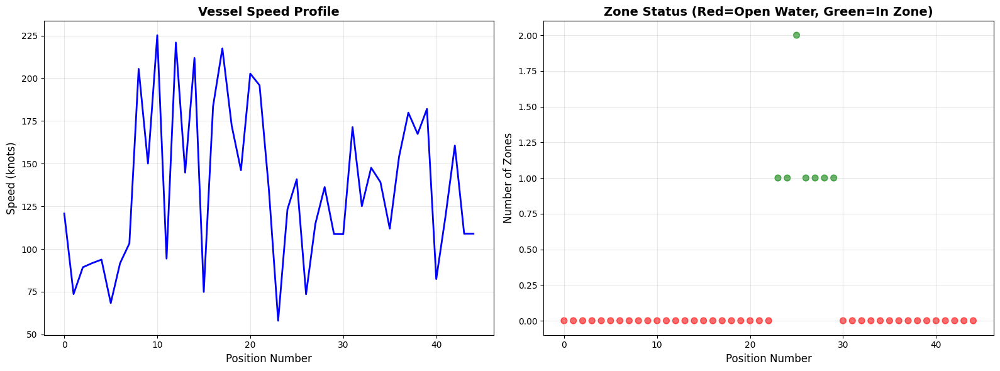


✓ All operations completed successfully!


In [13]:
"""
AIS Data Generator and Zone Detection System
Generates AIS data from vessel route and checks which zone/polygon the vessel is in
"""

import json
import pandas as pd
import numpy as np
from datetime import datetime, timedelta
from pathlib import Path
from shapely.geometry import Point, Polygon, shape
from shapely.ops import nearest_points
import matplotlib.pyplot as plt
from IPython.display import display

# ============================================================================
# PART 1: AIS DATA GENERATOR
# ============================================================================

class AISDataGenerator:
    """Generate realistic AIS data from vessel route coordinates"""
    
    def __init__(self, route_data, start_time="12:00:00", interval_minutes=15):
        """
        Initialize AIS data generator.
        
        Parameters:
        - route_data: GeoJSON dict or path to GeoJSON file
        - start_time: Start time in HH:MM:SS format
        - interval_minutes: Time interval between points
        """
        if isinstance(route_data, (str, Path)):
            with open(route_data, 'r') as f:
                route_data = json.load(f)
        
        self.route_data = route_data
        self.coordinates = self._extract_coordinates()
        self.start_time = datetime.strptime(f"2026-01-03 {start_time}", "%Y-%m-%d %H:%M:%S")
        self.interval = timedelta(minutes=interval_minutes)
        
    def _extract_coordinates(self):
        """Extract coordinates from GeoJSON"""
        features = self.route_data.get('features', [])
        if not features:
            raise ValueError("No features found in GeoJSON")
        
        geometry = features[0]['geometry']
        coords = geometry['coordinates']
        
        # Convert [lon, lat] to [lat, lon] for consistency
        return [[lat, lon] for lon, lat in coords]
    
    def calculate_speed(self, coord1, coord2, time_delta_hours):
        """Calculate speed in knots between two points"""
        from math import radians, cos, sin, asin, sqrt
        
        lat1, lon1 = coord1
        lat2, lon2 = coord2
        
        # Haversine formula
        lon1, lat1, lon2, lat2 = map(radians, [lon1, lat1, lon2, lat2])
        dlon = lon2 - lon1
        dlat = lat2 - lat1
        a = sin(dlat/2)**2 + cos(lat1) * cos(lat2) * sin(dlon/2)**2
        c = 2 * asin(sqrt(a))
        
        # Distance in nautical miles (6371 km * 0.539957 nm/km)
        distance_nm = 6371 * c * 0.539957
        
        # Speed in knots
        speed = distance_nm / time_delta_hours if time_delta_hours > 0 else 0
        return round(speed, 2)
    
    def calculate_heading(self, coord1, coord2):
        """Calculate heading/bearing between two points in degrees"""
        from math import radians, degrees, atan2, cos, sin
        
        lat1, lon1 = map(radians, coord1)
        lat2, lon2 = map(radians, coord2)
        
        dlon = lon2 - lon1
        
        x = sin(dlon) * cos(lat2)
        y = cos(lat1) * sin(lat2) - sin(lat1) * cos(lat2) * cos(dlon)
        
        heading = degrees(atan2(x, y))
        heading = (heading + 360) % 360  # Normalize to 0-360
        
        return round(heading, 1)
    
    def generate_ais_data(self, vessel_name="VESSEL_001", mmsi="123456789", 
                         imo="IMO1234567", callsign="ABCD123"):
        """
        Generate complete AIS data with timestamps and vessel info.
        
        Returns:
        - DataFrame with AIS data
        """
        ais_records = []
        time_delta_hours = self.interval.total_seconds() / 3600
        
        for i, (lat, lon) in enumerate(self.coordinates):
            timestamp = self.start_time + (i * self.interval)
            
            # Calculate speed and heading
            if i < len(self.coordinates) - 1:
                next_coord = self.coordinates[i + 1]
                speed = self.calculate_speed([lat, lon], next_coord, time_delta_hours)
                heading = self.calculate_heading([lat, lon], next_coord)
            else:
                # Last point - use previous values
                speed = ais_records[-1]['speed_knots'] if ais_records else 0
                heading = ais_records[-1]['heading'] if ais_records else 0
            
            record = {
                'timestamp': timestamp,
                'datetime_str': timestamp.strftime('%Y-%m-%d %H:%M:%S'),
                'date': timestamp.strftime('%Y-%m-%d'),
                'time': timestamp.strftime('%H:%M:%S'),
                'latitude': round(lat, 6),
                'longitude': round(lon, 6),
                'speed_knots': speed,
                'heading': heading,
                'vessel_name': vessel_name,
                'mmsi': mmsi,
                'imo': imo,
                'callsign': callsign,
                'nav_status': 'Under way using engine' if speed > 0 else 'At anchor',
                'point_number': i + 1
            }
            
            ais_records.append(record)
        
        df = pd.DataFrame(ais_records)
        return df
    
    def save_ais_data(self, df, output_folder="ais_data", formats=['csv', 'json']):
        """Save AIS data in multiple formats"""
        output_folder = Path(output_folder)
        output_folder.mkdir(exist_ok=True)
        
        timestamp_suffix = datetime.now().strftime('%Y%m%d_%H%M%S')
        saved_files = []
        
        if 'csv' in formats:
            csv_file = output_folder / f"ais_data_{timestamp_suffix}.csv"
            df.to_csv(csv_file, index=False)
            saved_files.append(csv_file)
            print(f"✓ Saved CSV: {csv_file}")
        
        if 'json' in formats:
            json_file = output_folder / f"ais_data_{timestamp_suffix}.json"
            
            # Create structured JSON
            ais_json = {
                'metadata': {
                    'vessel_name': df['vessel_name'].iloc[0],
                    'mmsi': df['mmsi'].iloc[0],
                    'imo': df['imo'].iloc[0],
                    'total_points': len(df),
                    'start_time': df['datetime_str'].iloc[0],
                    'end_time': df['datetime_str'].iloc[-1],
                    'duration_minutes': (len(df) - 1) * (self.interval.total_seconds() / 60)
                },
                'positions': df.to_dict('records')
            }
            
            with open(json_file, 'w') as f:
                json.dump(ais_json, f, indent=2, default=str)
            saved_files.append(json_file)
            print(f"✓ Saved JSON: {json_file}")
        
        return saved_files


# ============================================================================
# PART 2: ZONE CHECKER
# ============================================================================

class ZoneChecker:
    """Check which zone/polygon a vessel is in at each timestamp"""
    
    def __init__(self, zone_folders):
        """
        Initialize zone checker with polygon folders.
        
        Parameters:
        - zone_folders: List of folder paths containing zone polygon JSON files
        """
        self.zone_folders = [Path(f) for f in zone_folders]
        self.zones = []
        self.zone_polygons = []
        
    def load_zones(self):
        """Load all zone polygons"""
        print("Loading zone polygons...")
        
        for folder in self.zone_folders:
            if not folder.exists():
                print(f"⚠ Warning: Folder not found: {folder}")
                continue
            
            json_files = [f for f in folder.glob("*.json") 
                         if not f.name.startswith('_metadata')]
            
            print(f"\n📁 {folder.name}: Found {len(json_files)} files")
            
            for json_file in json_files:
                try:
                    with open(json_file, 'r') as f:
                        data = json.load(f)
                    
                    zone_name = data.get('name', json_file.stem.replace('_', ' ').title())
                    
                    # Extract polygons from features
                    features = data.get('features', [])
                    for feature in features:
                        geom = shape(feature['geometry'])
                        
                        self.zones.append({
                            'name': zone_name,
                            'filename': json_file.name,
                            'folder': folder.name,
                            'geometry': geom
                        })
                        self.zone_polygons.append(geom)
                    
                    print(f"  ✓ {json_file.name}")
                    
                except Exception as e:
                    print(f"  ✗ Error loading {json_file.name}: {e}")
        
        print(f"\n{'='*60}")
        print(f"Total zones loaded: {len(self.zones)}")
        print(f"{'='*60}\n")
        
        return self.zones
    
    def check_position(self, lat, lon):
        """
        Check which zone(s) a point is in.
        
        Returns:
        - List of zone names the point is within
        """
        point = Point(lon, lat)  # Shapely uses (lon, lat)
        zones_found = []
        
        for zone in self.zones:
            if zone['geometry'].contains(point):
                zones_found.append(zone['name'])
        
        return zones_found
    
    def find_nearest_zone(self, lat, lon):
        """Find the nearest zone if point is not within any zone"""
        point = Point(lon, lat)
        min_distance = float('inf')
        nearest_zone = None
        
        for zone in self.zones:
            distance = point.distance(zone['geometry'])
            if distance < min_distance:
                min_distance = distance
                nearest_zone = zone['name']
        
        # Convert distance to approximate km
        distance_km = min_distance * 111  # Rough conversion
        
        return nearest_zone, round(distance_km, 2)
    
    def analyze_ais_route(self, ais_df):
        """
        Analyze AIS data and determine which zone vessel is in at each timestamp.
        
        Parameters:
        - ais_df: DataFrame with AIS data
        
        Returns:
        - Enhanced DataFrame with zone information
        """
        print("Analyzing vessel route against zones...")
        
        results = []
        
        for idx, row in ais_df.iterrows():
            lat, lon = row['latitude'], row['longitude']
            
            # Check which zones the point is in
            zones_in = self.check_position(lat, lon)
            
            # Find nearest zone if not in any
            nearest_zone = None
            distance_to_nearest = None
            
            if not zones_in:
                nearest_zone, distance_to_nearest = self.find_nearest_zone(lat, lon)
            
            result = {
                'timestamp': row['timestamp'],
                'datetime_str': row['datetime_str'],
                'latitude': lat,
                'longitude': lon,
                'speed_knots': row['speed_knots'],
                'heading': row['heading'],
                'in_zone': ', '.join(zones_in) if zones_in else 'Open Water',
                'num_zones': len(zones_in),
                'nearest_zone': nearest_zone,
                'distance_to_zone_km': distance_to_nearest,
                'point_number': row['point_number']
            }
            
            results.append(result)
        
        results_df = pd.DataFrame(results)
        
        print(f"✓ Analysis complete: {len(results_df)} positions analyzed")
        
        return results_df
    
    def get_zone_summary(self, results_df):
        """Generate summary statistics of zone passages"""
        summary = {
            'total_positions': len(results_df),
            'positions_in_zones': len(results_df[results_df['num_zones'] > 0]),
            'positions_in_open_water': len(results_df[results_df['num_zones'] == 0]),
            'zones_encountered': []
        }
        
        # Count time in each zone
        zone_counts = results_df[results_df['num_zones'] > 0]['in_zone'].value_counts()
        
        for zone, count in zone_counts.items():
            summary['zones_encountered'].append({
                'zone_name': zone,
                'num_positions': int(count),
                'percentage': round(count / len(results_df) * 100, 2)
            })
        
        return summary
    
    def save_analysis(self, results_df, output_folder="ais_analysis"):
        """Save zone analysis results"""
        output_folder = Path(output_folder)
        output_folder.mkdir(exist_ok=True)
        
        timestamp_suffix = datetime.now().strftime('%Y%m%d_%H%M%S')
        
        # Save detailed results
        csv_file = output_folder / f"ais_zone_analysis_{timestamp_suffix}.csv"
        results_df.to_csv(csv_file, index=False)
        print(f"✓ Saved analysis CSV: {csv_file}")
        
        # Save summary
        summary = self.get_zone_summary(results_df)
        summary_file = output_folder / f"ais_zone_summary_{timestamp_suffix}.json"
        with open(summary_file, 'w') as f:
            json.dump(summary, f, indent=2)
        print(f"✓ Saved summary JSON: {summary_file}")
        
        return csv_file, summary_file


# ============================================================================
# MAIN EXECUTION
# ============================================================================

# Your route data
route_geojson = {
  "type": "FeatureCollection",
  "features": [
    {
      "type": "Feature",
      "properties": {},
      "geometry": {
        "coordinates": [
          [67.54584948935559, 3.0821105278375],
          [68.04906528254546, 3.0602630043073447],
          [68.35537054796552, 3.0821105278375],
          [68.63979686585489, 3.322402985296222],
          [68.96798107880397, 3.5189625911938123],
          [69.31804423928381, 3.6936475079227336],
          [69.60247055717312, 3.7154807387012454],
          [69.93065477012226, 3.911955125203704],
          [70.32447582566186, 4.086560427237941],
          [71.13399688427003, 4.370212263778271],
          [71.68097057251973, 4.675563301871975],
          [72.62176531630723, 4.675563301871975],
          [72.94994952925632, 4.89359023861428],
          [73.86886532551483, 4.806387809653387],
          [74.32832322364499, 5.198707952285957],
          [75.1597232297839, 5.503677902273154],
          [75.44414954767322, 5.634331952509186],
          [76.1661548161619, 5.895551221253825],
          [76.99755482230091, 6.265400162462953],
          [77.58828640560859, 6.678450077529405],
          [78.09150219879848, 7.026012243806946],
          [78.68223378210786, 7.633613697821346],
          [79.20732852282674, 8.262005270945096],
          [79.36048115553683, 8.802922930547282],
          [79.46987589318536, 9.01907151583633],
          [79.60114957836635, 9.515717457849036],
          [79.9512127388445, 9.990096331309076],
          [80.19188116167402, 10.18396308582318],
          [80.47630747956515, 10.571341152993071],
          [80.93576537769349, 10.915267918620955],
          [81.32958643323315, 11.151487612788642],
          [81.7234074887727, 11.387515484637731],
          [82.27038117702068, 11.858980392567375],
          [82.44541275726141, 12.351005514631893],
          [82.66420223256029, 12.927419365497258],
          [82.83923381280101, 13.481230090884921],
          [83.03614434057079, 13.906369656326078],
          [83.4080864485797, 14.43669522098962],
          [83.97693908435838, 14.94462225624973],
          [84.67706540531805, 15.113666644632147],
          [85.4428285688665, 15.282576440894005],
          [85.68349699169607, 15.535685802441506],
          [85.98980225711438, 15.935805564990588],
          [86.49301805030427, 16.39810620496597],
          [86.88683910584393, 16.64981036450378]
        ],
        "type": "LineString"
      }
    }
  ]
}

print("="*80)
print("AIS DATA GENERATOR AND ZONE CHECKER")
print("="*80)

# STEP 1: Generate AIS Data
print("\n--- STEP 1: GENERATING AIS DATA ---\n")
ais_generator = AISDataGenerator(
    route_data=route_geojson,
    start_time="12:00:00",
    interval_minutes=15
)

ais_df = ais_generator.generate_ais_data(
    vessel_name="MV_OCEAN_EXPLORER",
    mmsi="356789012",
    imo="IMO9876543",
    callsign="OCEX123"
)

print(f"\n✓ Generated {len(ais_df)} AIS positions")
print(f"✓ Start time: {ais_df['datetime_str'].iloc[0]}")
print(f"✓ End time: {ais_df['datetime_str'].iloc[-1]}")
print(f"✓ Total duration: {(len(ais_df) - 1) * 15} minutes")
print(f"✓ Average speed: {ais_df['speed_knots'].mean():.2f} knots")

# Display first few records
print("\n--- First 10 AIS Records ---")
display(ais_df[['datetime_str', 'latitude', 'longitude', 'speed_knots', 'heading']].head(10))

# Save AIS data
ais_files = ais_generator.save_ais_data(ais_df, formats=['csv', 'json'])

# STEP 2: Load Zones and Analyze Route
print("\n\n--- STEP 2: LOADING ZONES AND ANALYZING ROUTE ---\n")

# Define your zone folders
zone_folders = [
    "/home/crimsondeepdarshak/Desktop/Deep_Darshak/References/Build_1_docs/Straits_polygon/Straits_boundaries",
    # Add more folders if you have custom zones
    # "custom_straits_polygons"
]

zone_checker = ZoneChecker(zone_folders)
zones = zone_checker.load_zones()

# Analyze the route
results_df = zone_checker.analyze_ais_route(ais_df)

# Display results
print("\n--- Zone Analysis Results (First 10) ---")
display(results_df[['datetime_str', 'latitude', 'longitude', 'in_zone', 'nearest_zone', 'distance_to_zone_km']].head(10))

# Get summary
summary = zone_checker.get_zone_summary(results_df)

print("\n--- ZONE PASSAGE SUMMARY ---")
print(f"Total positions analyzed: {summary['total_positions']}")
print(f"Positions in zones: {summary['positions_in_zones']}")
print(f"Positions in open water: {summary['positions_in_open_water']}")
print(f"\nZones encountered:")
for zone_info in summary['zones_encountered']:
    print(f"  • {zone_info['zone_name']}: {zone_info['num_positions']} positions ({zone_info['percentage']}%)")

# Save analysis
analysis_files = zone_checker.save_analysis(results_df)

print("\n" + "="*80)
print("ANALYSIS COMPLETE!")
print("="*80)
print(f"\nGenerated files:")
for f in ais_files + list(analysis_files):
    print(f"  • {f}")

# Optional: Create visualization
print("\n--- Creating Route Visualization ---")
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))

# Plot 1: Speed over time
ax1.plot(range(len(results_df)), results_df['speed_knots'], 'b-', linewidth=2)
ax1.set_xlabel('Position Number', fontsize=12)
ax1.set_ylabel('Speed (knots)', fontsize=12)
ax1.set_title('Vessel Speed Profile', fontsize=14, fontweight='bold')
ax1.grid(True, alpha=0.3)

# Plot 2: Zone status
zone_status = results_df['num_zones'].values
colors = ['red' if z == 0 else 'green' for z in zone_status]
ax2.scatter(range(len(results_df)), zone_status, c=colors, s=50, alpha=0.6)
ax2.set_xlabel('Position Number', fontsize=12)
ax2.set_ylabel('Number of Zones', fontsize=12)
ax2.set_title('Zone Status (Red=Open Water, Green=In Zone)', fontsize=14, fontweight='bold')
ax2.grid(True, alpha=0.3)

plt.tight_layout()
plt.savefig('ais_analysis_visualization.png', dpi=150, bbox_inches='tight')
print("✓ Saved visualization: ais_analysis_visualization.png")
plt.show()

print("\n✓ All operations completed successfully!")

In [15]:
"""
Distance Calculation Methodology and Interactive Visualization
Explains the methodology and visualizes AIS data with zone analysis
"""

import json
import pandas as pd
import numpy as np
from datetime import datetime, timedelta
from pathlib import Path
from shapely.geometry import Point, Polygon, LineString, shape
from shapely.ops import nearest_points
import folium
from folium import plugins
import matplotlib.pyplot as plt
from matplotlib.patches import Polygon as MPLPolygon
from IPython.display import display, HTML
import warnings
warnings.filterwarnings('ignore')

# ============================================================================
# PART 1: DISTANCE CALCULATION METHODOLOGY EXPLANATION
# ============================================================================

print("="*80)
print("DISTANCE CALCULATION METHODOLOGY")
print("="*80)

methodology_text = """
OVERVIEW:
---------
The distance calculation uses the Shapely library (built on GEOS - Geometry Engine 
Open Source), which provides robust computational geometry algorithms.

LIBRARIES USED:
--------------
1. Shapely: Computational geometry library (point-in-polygon, distance calculations)
2. GEOS: C++ geometry engine that Shapely wraps
3. Pandas: Data manipulation
4. NumPy: Numerical operations

KEY CONCEPTS:
------------

1. POINT-IN-POLYGON DETECTION:
   - Uses ray-casting algorithm (Shapely's contains() method)
   - Casts a ray from the point to infinity
   - Counts intersections with polygon boundary
   - Odd intersections = inside, Even = outside
   - Time Complexity: O(n) where n = number of polygon vertices

2. DISTANCE CALCULATION (When NOT in polygon):
   - Uses Shapely's distance() method
   - Calculates minimum Euclidean distance to polygon boundary
   - Returns distance in decimal degrees
   - Converted to kilometers using approximation: 1 degree ≈ 111 km at equator

3. NEAREST POINT CALCULATION:
   - Uses Shapely's nearest_points() function
   - Finds closest point on polygon boundary to vessel position
   - Returns tuple: (point_on_vessel, point_on_boundary)

COORDINATE SYSTEMS:
------------------
- Input: WGS84 (latitude, longitude) in decimal degrees
- Shapely uses: (longitude, latitude) order - IMPORTANT!
- Distance output: Decimal degrees → converted to kilometers

ACCURACY CONSIDERATIONS:
-----------------------
1. Spherical Earth approximation: 
   - 1° latitude ≈ 111 km (constant)
   - 1° longitude ≈ 111 km × cos(latitude) (varies by latitude)
   - Our code uses simple 111 km conversion (acceptable for small distances)

2. For higher accuracy, use:
   - Haversine formula (great-circle distance)
   - Vincenty formula (ellipsoidal distance)
   - GeoPy library for geodesic calculations

ALGORITHM FLOW:
--------------
For each AIS position (lat, lon):
  1. Create Shapely Point(lon, lat)  # Note: lon, lat order!
  2. For each zone polygon:
     a. Check if point.within(polygon) or polygon.contains(point)
     b. If True: vessel is IN zone
     c. If False: calculate point.distance(polygon)
  3. If not in any zone:
     - Find minimum distance across all polygons
     - Identify zone with minimum distance
     - Calculate nearest point on boundary
  4. Store results with timestamp
"""

print(methodology_text)

# ============================================================================
# PART 2: CODE EXAMPLE WITH DETAILED EXPLANATION
# ============================================================================

print("\n" + "="*80)
print("CODE EXAMPLE: Distance Calculation Walkthrough")
print("="*80 + "\n")

def detailed_distance_example():
    """Demonstrate distance calculation with detailed output"""
    
    # Example 1: Simple square zone
    print("EXAMPLE 1: Simple Square Zone")
    print("-" * 40)
    
    # Create a square zone (10x10 degrees)
    zone_coords = [
        (70, 5),   # lon, lat
        (80, 5),
        (80, 15),
        (70, 15),
        (70, 5)    # Close the polygon
    ]
    zone_polygon = Polygon(zone_coords)
    
    print(f"Zone boundaries: {zone_coords[:4]}")
    print(f"Zone area: {zone_polygon.area:.2f} square degrees")
    
    # Test Point 1: Inside the zone
    point1_lat, point1_lon = 10.0, 75.0
    point1 = Point(point1_lon, point1_lat)
    
    print(f"\nTest Point 1: ({point1_lat}°N, {point1_lon}°E)")
    print(f"  Is inside zone? {zone_polygon.contains(point1)}")
    
    if zone_polygon.contains(point1):
        print(f"  Distance to boundary: 0 km (inside zone)")
    else:
        distance_deg = point1.distance(zone_polygon)
        distance_km = distance_deg * 111
        print(f"  Distance to boundary: {distance_km:.2f} km")
    
    # Test Point 2: Outside the zone
    point2_lat, point2_lon = 3.0, 67.0
    point2 = Point(point2_lon, point2_lat)
    
    print(f"\nTest Point 2: ({point2_lat}°N, {point2_lon}°E)")
    print(f"  Is inside zone? {zone_polygon.contains(point2)}")
    
    if not zone_polygon.contains(point2):
        distance_deg = point2.distance(zone_polygon)
        distance_km = distance_deg * 111
        
        # Find nearest point on boundary
        nearest_geom = nearest_points(point2, zone_polygon)
        nearest_on_vessel = nearest_geom[0]
        nearest_on_boundary = nearest_geom[1]
        
        print(f"  Distance to boundary: {distance_km:.2f} km")
        print(f"  Nearest point on vessel: ({nearest_on_vessel.y:.2f}°N, {nearest_on_vessel.x:.2f}°E)")
        print(f"  Nearest point on boundary: ({nearest_on_boundary.y:.2f}°N, {nearest_on_boundary.x:.2f}°E)")
    
    # Example 2: Complex polygon (strait-like)
    print("\n" + "="*80)
    print("EXAMPLE 2: Complex Strait-like Zone")
    print("-" * 40)
    
    strait_coords = [
        (67.5, 3.0),
        (68.5, 3.5),
        (69.5, 4.0),
        (69.0, 5.0),
        (68.0, 4.5),
        (67.0, 4.0),
        (67.5, 3.0)
    ]
    strait_polygon = Polygon(strait_coords)
    
    # Test multiple points
    test_points = [
        (3.5, 68.0, "Point A - Near center"),
        (6.0, 70.0, "Point B - North of strait"),
        (2.5, 66.5, "Point C - South-west of strait")
    ]
    
    for lat, lon, description in test_points:
        point = Point(lon, lat)
        is_inside = strait_polygon.contains(point)
        
        print(f"\n{description}: ({lat}°N, {lon}°E)")
        print(f"  Inside strait? {is_inside}")
        
        if not is_inside:
            distance_deg = point.distance(strait_polygon)
            distance_km = distance_deg * 111
            
            # Calculate nearest point
            nearest_geom = nearest_points(point, strait_polygon)
            nearest_boundary = nearest_geom[1]
            
            print(f"  Distance to strait: {distance_km:.2f} km")
            print(f"  Nearest boundary point: ({nearest_boundary.y:.2f}°N, {nearest_boundary.x:.2f}°E)")
            
            # Calculate bearing to nearest point (bonus!)
            from math import atan2, degrees
            dlon = nearest_boundary.x - lon
            dlat = nearest_boundary.y - lat
            bearing = degrees(atan2(dlon, dlat)) % 360
            print(f"  Bearing to nearest point: {bearing:.1f}°")

detailed_distance_example()

# ============================================================================
# PART 3: VISUALIZATION OF AIS DATA WITH ZONE ANALYSIS
# ============================================================================

print("\n\n" + "="*80)
print("INTERACTIVE VISUALIZATION")
print("="*80 + "\n")

class AISZoneVisualizer:
    """Interactive visualization of AIS data with zone analysis"""
    
    def __init__(self):
        self.ais_data = None
        self.zones = []
        
    def load_sample_data(self):
        """Load the sample AIS data and zones"""
        # This would be loaded from the actual analysis
        # For now, we'll create sample data structure
        print("Loading AIS data and zone information...")
        
    def create_interactive_map(self, ais_df, zones, zone_folders):
        """
        Create interactive Folium map with:
        - AIS track line
        - Timestamped markers
        - Zone polygons
        - Distance lines to nearest zones
        - Popup information
        """
        
        if ais_df is None or len(ais_df) == 0:
            print("No AIS data to visualize")
            return None
        
        # Calculate map center
        center_lat = ais_df['latitude'].mean()
        center_lon = ais_df['longitude'].mean()
        
        # Create base map
        m = folium.Map(
            location=[center_lat, center_lon],
            zoom_start=6,
            tiles='OpenStreetMap'
        )
        
        # Add tile layers
        folium.TileLayer('CartoDB positron', name='Light Mode').add_to(m)
        folium.TileLayer('CartoDB dark_matter', name='Dark Mode').add_to(m)
        
        # 1. ADD ZONE POLYGONS
        zone_group = folium.FeatureGroup(name='Zone Boundaries', show=True)
        
        colors = ['red', 'blue', 'green', 'purple', 'orange']
        for idx, zone in enumerate(zones):
            color = colors[idx % len(colors)]
            
            folium.GeoJson(
                zone['geometry'],
                name=zone['name'],
                style_function=lambda x, color=color: {
                    'fillColor': color,
                    'color': color,
                    'weight': 2,
                    'fillOpacity': 0.2
                },
                tooltip=zone['name']
            ).add_to(zone_group)
        
        zone_group.add_to(m)
        
        # 2. ADD AIS TRACK LINE
        track_coordinates = [[row['latitude'], row['longitude']] 
                            for _, row in ais_df.iterrows()]
        
        folium.PolyLine(
            track_coordinates,
            color='navy',
            weight=3,
            opacity=0.7,
            tooltip='Vessel Track'
        ).add_to(m)
        
        # 3. ADD TIMESTAMPED MARKERS WITH DETAILED INFO
        marker_group = folium.FeatureGroup(name='AIS Positions', show=True)
        
        for idx, row in ais_df.iterrows():
            # Determine marker color based on zone status
            if row['num_zones'] > 0:
                marker_color = 'green'
                icon = 'ship'
                status = 'IN ZONE'
            else:
                marker_color = 'red'
                icon = 'circle'
                status = 'OPEN WATER'
            
            # Create detailed popup
            popup_html = f"""
            <div style="width: 300px; font-family: Arial;">
                <h4 style="margin: 0 0 10px 0; color: #2c3e50;">
                    <b>Position #{row['point_number']}</b>
                </h4>
                <hr style="margin: 5px 0;">
                
                <table style="width: 100%; font-size: 12px;">
                    <tr>
                        <td><b>Timestamp:</b></td>
                        <td>{row['datetime_str']}</td>
                    </tr>
                    <tr>
                        <td><b>Status:</b></td>
                        <td style="color: {'green' if row['num_zones'] > 0 else 'red'};">
                            <b>{status}</b>
                        </td>
                    </tr>
                    <tr><td colspan="2"><hr style="margin: 5px 0;"></td></tr>
                    
                    <tr>
                        <td><b>Latitude:</b></td>
                        <td>{row['latitude']:.6f}°</td>
                    </tr>
                    <tr>
                        <td><b>Longitude:</b></td>
                        <td>{row['longitude']:.6f}°</td>
                    </tr>
                    <tr>
                        <td><b>Speed:</b></td>
                        <td>{row['speed_knots']:.2f} knots</td>
                    </tr>
                    <tr>
                        <td><b>Heading:</b></td>
                        <td>{row['heading']:.1f}°</td>
                    </tr>
                    <tr><td colspan="2"><hr style="margin: 5px 0;"></td></tr>
                    
                    <tr>
                        <td><b>Current Zone:</b></td>
                        <td>{row['in_zone']}</td>
                    </tr>
                    <tr>
                        <td><b>Num Zones:</b></td>
                        <td>{row['num_zones']}</td>
                    </tr>
            """
            
            if row['nearest_zone'] and row['distance_to_zone_km']:
                popup_html += f"""
                    <tr>
                        <td><b>Nearest Zone:</b></td>
                        <td>{row['nearest_zone']}</td>
                    </tr>
                    <tr>
                        <td><b>Distance:</b></td>
                        <td style="color: orange;"><b>{row['distance_to_zone_km']:.2f} km</b></td>
                    </tr>
                """
            
            popup_html += """
                </table>
            </div>
            """
            
            # Add marker
            folium.Marker(
                location=[row['latitude'], row['longitude']],
                popup=folium.Popup(popup_html, max_width=350),
                tooltip=f"Point {row['point_number']}: {row['datetime_str']}",
                icon=folium.Icon(color=marker_color, icon=icon, prefix='fa')
            ).add_to(marker_group)
            
            # 4. ADD DISTANCE LINES TO NEAREST ZONES (if in open water)
            if row['num_zones'] == 0 and row['nearest_zone']:
                # Find nearest point on zone boundary
                vessel_point = Point(row['longitude'], row['latitude'])
                
                for zone in zones:
                    if zone['name'] == row['nearest_zone']:
                        nearest_geom = nearest_points(vessel_point, zone['geometry'])
                        nearest_boundary = nearest_geom[1]
                        
                        # Draw dashed line to nearest boundary point
                        folium.PolyLine(
                            [
                                [row['latitude'], row['longitude']],
                                [nearest_boundary.y, nearest_boundary.x]
                            ],
                            color='orange',
                            weight=2,
                            opacity=0.6,
                            dash_array='10, 5',
                            tooltip=f"Distance: {row['distance_to_zone_km']:.2f} km to {row['nearest_zone']}"
                        ).add_to(marker_group)
                        
                        # Add small marker at nearest boundary point
                        folium.CircleMarker(
                            location=[nearest_boundary.y, nearest_boundary.x],
                            radius=4,
                            color='orange',
                            fill=True,
                            fillColor='orange',
                            fillOpacity=0.8,
                            tooltip=f"Nearest point on {row['nearest_zone']}"
                        ).add_to(marker_group)
                        
                        break
        
        marker_group.add_to(m)
        
        # 5. ADD TIMELINE VISUALIZATION
        # Create a heatmap of vessel positions over time
        heat_data = [[row['latitude'], row['longitude']] 
                     for _, row in ais_df.iterrows()]
        
        plugins.HeatMap(
            heat_data,
            name='Density Heatmap',
            min_opacity=0.2,
            radius=15,
            blur=20,
            show=False
        ).add_to(m)
        
        # 6. ADD CONTROLS
        folium.LayerControl(collapsed=False).add_to(m)
        
        plugins.Fullscreen(
            position='topright',
            title='Fullscreen mode'
        ).add_to(m)
        
        plugins.MeasureControl(
            position='topleft',
            primary_length_unit='kilometers'
        ).add_to(m)
        
        plugins.MiniMap(toggle_display=True).add_to(m)
        
        # Add custom legend
        legend_html = '''
        <div style="position: fixed; 
                    bottom: 50px; right: 50px; 
                    width: 220px; height: auto; 
                    background-color: white; 
                    border:2px solid grey; 
                    z-index:9999; 
                    font-size:14px;
                    padding: 10px;
                    border-radius: 5px;
                    box-shadow: 0 0 15px rgba(0,0,0,0.2);
                    ">
            <h4 style="margin: 0 0 10px 0;">Legend</h4>
            <p style="margin: 5px 0;">
                <i class="fa fa-ship" style="color:green"></i> In Zone
            </p>
            <p style="margin: 5px 0;">
                <i class="fa fa-circle" style="color:red"></i> Open Water
            </p>
            <p style="margin: 5px 0;">
                <span style="color:navy; font-weight:bold;">━━━</span> Vessel Track
            </p>
            <p style="margin: 5px 0;">
                <span style="color:orange; font-weight:bold;">╌╌╌</span> Distance to Zone
            </p>
        </div>
        '''
        m.get_root().html.add_child(folium.Element(legend_html))
        
        return m
    
    def create_analysis_plots(self, ais_df):
        """Create detailed analysis plots"""
        
        fig = plt.figure(figsize=(18, 12))
        gs = fig.add_gridspec(3, 3, hspace=0.3, wspace=0.3)
        
        # Plot 1: Route on map coordinates
        ax1 = fig.add_subplot(gs[0:2, 0:2])
        
        # Color code by zone status
        in_zone = ais_df[ais_df['num_zones'] > 0]
        open_water = ais_df[ais_df['num_zones'] == 0]
        
        ax1.plot(ais_df['longitude'], ais_df['latitude'], 
                'k-', alpha=0.3, linewidth=1, label='Track')
        
        if len(in_zone) > 0:
            ax1.scatter(in_zone['longitude'], in_zone['latitude'], 
                       c='green', s=100, alpha=0.7, label='In Zone', 
                       edgecolors='black', linewidths=1, zorder=5)
        
        if len(open_water) > 0:
            ax1.scatter(open_water['longitude'], open_water['latitude'], 
                       c='red', s=100, alpha=0.7, label='Open Water',
                       edgecolors='black', linewidths=1, zorder=5)
        
        # Annotate first and last points
        ax1.scatter(ais_df['longitude'].iloc[0], ais_df['latitude'].iloc[0],
                   c='blue', s=200, marker='*', edgecolors='black', 
                   linewidths=2, label='Start', zorder=10)
        ax1.scatter(ais_df['longitude'].iloc[-1], ais_df['latitude'].iloc[-1],
                   c='purple', s=200, marker='*', edgecolors='black', 
                   linewidths=2, label='End', zorder=10)
        
        ax1.set_xlabel('Longitude (°E)', fontsize=12, fontweight='bold')
        ax1.set_ylabel('Latitude (°N)', fontsize=12, fontweight='bold')
        ax1.set_title('Vessel Route with Zone Status', fontsize=14, fontweight='bold')
        ax1.grid(True, alpha=0.3)
        ax1.legend(loc='best', framealpha=0.9)
        
        # Plot 2: Speed over time
        ax2 = fig.add_subplot(gs[0, 2])
        ax2.plot(range(len(ais_df)), ais_df['speed_knots'], 
                'b-', linewidth=2, marker='o', markersize=4)
        ax2.fill_between(range(len(ais_df)), ais_df['speed_knots'], 
                         alpha=0.3, color='blue')
        ax2.set_xlabel('Position Number', fontsize=10)
        ax2.set_ylabel('Speed (knots)', fontsize=10, fontweight='bold')
        ax2.set_title('Speed Profile', fontsize=12, fontweight='bold')
        ax2.grid(True, alpha=0.3)
        ax2.axhline(y=ais_df['speed_knots'].mean(), color='r', 
                   linestyle='--', label=f"Avg: {ais_df['speed_knots'].mean():.1f} kn")
        ax2.legend()
        
        # Plot 3: Heading changes
        ax3 = fig.add_subplot(gs[1, 2])
        ax3.plot(range(len(ais_df)), ais_df['heading'], 
                'g-', linewidth=2, marker='o', markersize=4)
        ax3.set_xlabel('Position Number', fontsize=10)
        ax3.set_ylabel('Heading (°)', fontsize=10, fontweight='bold')
        ax3.set_title('Heading Changes', fontsize=12, fontweight='bold')
        ax3.set_ylim(0, 360)
        ax3.grid(True, alpha=0.3)
        
        # Plot 4: Distance to nearest zone
        ax4 = fig.add_subplot(gs[2, :2])
        
        # Fill areas based on zone status
        for i in range(len(ais_df)):
            if ais_df.iloc[i]['num_zones'] > 0:
                ax4.axvspan(i-0.5, i+0.5, color='green', alpha=0.2)
            else:
                distance = ais_df.iloc[i]['distance_to_zone_km']
                if distance and distance > 0:
                    ax4.bar(i, distance, color='orange', alpha=0.6, 
                           edgecolor='black', linewidth=0.5)
        
        ax4.set_xlabel('Position Number', fontsize=12, fontweight='bold')
        ax4.set_ylabel('Distance to Nearest Zone (km)', fontsize=12, fontweight='bold')
        ax4.set_title('Distance to Nearest Zone (Green = Inside Zone)', 
                     fontsize=14, fontweight='bold')
        ax4.grid(True, alpha=0.3, axis='y')
        
        # Plot 5: Zone status pie chart
        ax5 = fig.add_subplot(gs[2, 2])
        zone_counts = [
            len(ais_df[ais_df['num_zones'] > 0]),
            len(ais_df[ais_df['num_zones'] == 0])
        ]
        colors_pie = ['green', 'red']
        labels_pie = [
            f'In Zone\n({zone_counts[0]} points)',
            f'Open Water\n({zone_counts[1]} points)'
        ]
        
        ax5.pie(zone_counts, labels=labels_pie, colors=colors_pie, 
               autopct='%1.1f%%', startangle=90, textprops={'fontsize': 10})
        ax5.set_title('Zone Status Distribution', fontsize=12, fontweight='bold')
        
        plt.suptitle('AIS Data Comprehensive Analysis', 
                    fontsize=16, fontweight='bold', y=0.995)
        
        return fig

# Placeholder for running with actual data
print("""
To run the full visualization with your AIS data, use:

# After running the AIS generator and zone checker:
visualizer = AISZoneVisualizer()
interactive_map = visualizer.create_interactive_map(results_df, zones, zone_folders)
display(interactive_map)

# Save the map
interactive_map.save('ais_zone_visualization.html')

# Create analysis plots
fig = visualizer.create_analysis_plots(results_df)
plt.savefig('ais_analysis_plots.png', dpi=150, bbox_inches='tight')
plt.show()
""")

print("\n" + "="*80)
print("SUMMARY OF DISTANCE CALCULATION")
print("="*80)

summary = """
KEY TAKEAWAYS:
-------------
1. Point-in-Polygon: O(n) ray-casting algorithm via Shapely
2. Distance Calculation: Euclidean distance in decimal degrees
3. Conversion Factor: 1° ≈ 111 km (simplified)
4. Library: Shapely (wraps GEOS C++ library)
5. Coordinate Order: (longitude, latitude) in Shapely - IMPORTANT!

VISUALIZATION FEATURES:
----------------------
✓ Color-coded markers (green=in zone, red=open water)
✓ Dashed orange lines showing distance to nearest zone
✓ Detailed popups with all AIS data at each timestamp
✓ Interactive layer controls
✓ Heatmap overlay for density analysis
✓ Comprehensive statistical plots

OUTPUT FILES:
------------
- ais_zone_visualization.html (interactive map)
- ais_analysis_plots.png (statistical charts)
"""

print(summary)

DISTANCE CALCULATION METHODOLOGY

OVERVIEW:
---------
The distance calculation uses the Shapely library (built on GEOS - Geometry Engine 
Open Source), which provides robust computational geometry algorithms.

LIBRARIES USED:
--------------
1. Shapely: Computational geometry library (point-in-polygon, distance calculations)
2. GEOS: C++ geometry engine that Shapely wraps
3. Pandas: Data manipulation
4. NumPy: Numerical operations

KEY CONCEPTS:
------------

1. POINT-IN-POLYGON DETECTION:
   - Uses ray-casting algorithm (Shapely's contains() method)
   - Casts a ray from the point to infinity
   - Counts intersections with polygon boundary
   - Odd intersections = inside, Even = outside
   - Time Complexity: O(n) where n = number of polygon vertices

2. DISTANCE CALCULATION (When NOT in polygon):
   - Uses Shapely's distance() method
   - Calculates minimum Euclidean distance to polygon boundary
   - Returns distance in decimal degrees
   - Converted to kilometers using approximation: 

CREATING COMPLETE INTERACTIVE VISUALIZATION

Building interactive map with:
  ✓ Zone boundary polygons
  ✓ Vessel track line
  ✓ Timestamped position markers
  ✓ Distance lines to nearest zones
  ✓ Detailed popups with all data
  ✓ Interactive controls and legend

--- INTERACTIVE MAP ---



✓ Saved interactive map to: ais_complete_visualization.html

--- GENERATING ANALYSIS PLOTS ---
✓ Saved analysis plots to: ais_complete_analysis.png


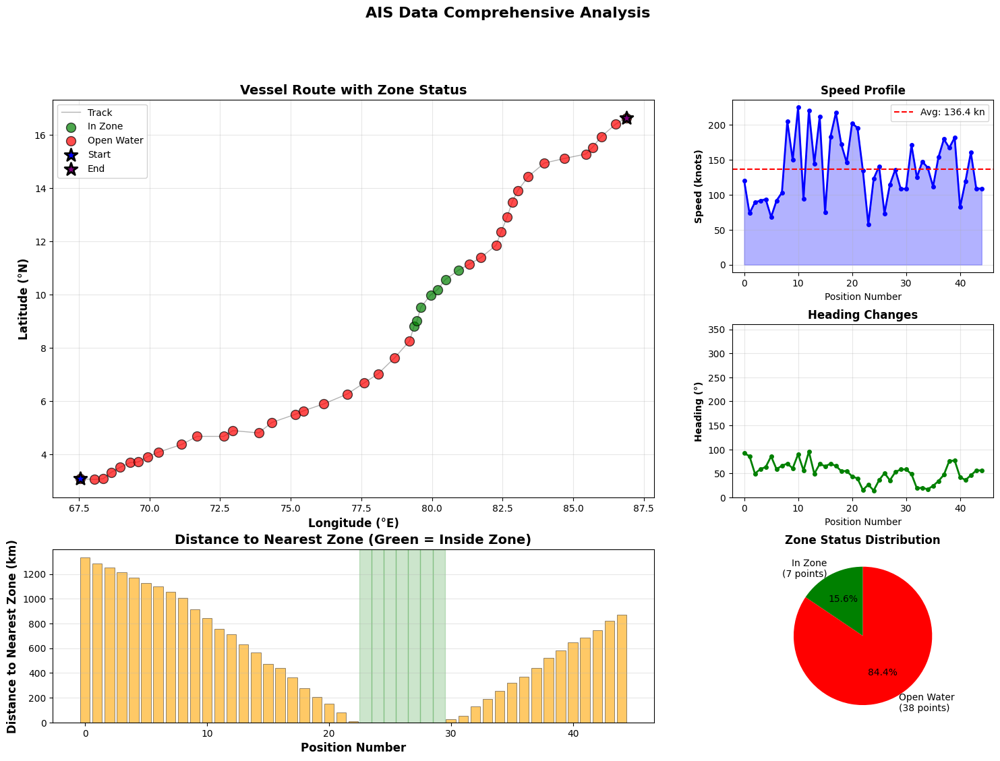


DETAILED STATISTICS

Vessel Information:
  • Total positions: 45
  • Journey duration: 660 minutes
  • Average speed: 136.37 knots
  • Max speed: 225.19 knots
  • Min speed: 58.04 knots

Zone Analysis:
  • Positions in zones: 7 (15.6%)
  • Positions in open water: 38 (84.4%)

  Zones encountered:
    • Palk Strait Bounding Box: 6 positions (13.3%)
    • Palk Strait Bounding Box, Palk_strait_manual: 1 positions (2.2%)

Distance to Nearest Zone (Open Water positions):
  • Average: 621.21 km
  • Maximum: 1332.46 km
  • Minimum: 10.90 km

Timeline:
  • Start: 2026-01-03 12:00:00
  • End: 2026-01-03 23:00:00

SAMPLE DATA (First 5 positions)


,timestamp,datetime_str,latitude,longitude,speed_knots,heading,in_zone,num_zones,nearest_zone,distance_to_zone_km,point_number
0,2026-01-03 12:00:00,2026-01-03 12:00:00,3.082111,67.545849,120.79,92.5,Open Water,0,Palk Strait Bounding Box,1332.46,1
1,2026-01-03 12:15:00,2026-01-03 12:15:00,3.060263,68.049065,73.64,85.9,Open Water,0,Palk Strait Bounding Box,1283.63,2
2,2026-01-03 12:30:00,2026-01-03 12:30:00,3.082111,68.355371,89.34,49.8,Open Water,0,Palk Strait Bounding Box,1252.37,3
3,2026-01-03 12:45:00,2026-01-03 12:45:00,3.322403,68.639797,91.75,59.0,Open Water,0,Palk Strait Bounding Box,1212.03,4
4,2026-01-03 13:00:00,2026-01-03 13:00:00,3.518963,68.967981,93.81,63.4,Open Water,0,Palk Strait Bounding Box,1169.64,5



DISTANCE CALCULATION METHODOLOGY SUMMARY

HOW DISTANCES ARE CALCULATED:
-----------------------------

1. LIBRARY USED: Shapely (Python wrapper for GEOS C++ library)
   - Industry-standard computational geometry library
   - Used in GIS applications worldwide
   - Highly optimized C++ backend

2. ALGORITHM FOR POINT-IN-POLYGON:
   - Ray Casting Algorithm
   - Cast ray from point to infinity
   - Count intersections with polygon edges
   - Odd number = INSIDE, Even number = OUTSIDE
   - Time complexity: O(n) where n = vertices

3. DISTANCE CALCULATION STEPS:

   Step A: Create Shapely Point object
   ┌─────────────────────────────────────────┐
   │ vessel_point = Point(lon, lat)          │
   │ Note: Shapely uses (lon, lat) order!   │
   └─────────────────────────────────────────┘

   Step B: Calculate distance to polygon
   ┌─────────────────────────────────────────┐
   │ distance_deg = vessel_point.distance(   │
   │                    zone_polygon)        │
   │ Returns: Euclidean d

In [16]:
"""
COMPLETE AIS VISUALIZATION SYSTEM
Integrates AIS data generation, zone checking, and interactive visualization
Run this cell to see the complete workflow
"""

# This assumes you've already run the AIS generator and zone checker
# and have results_df and zones available

# If not, uncomment and run these first:
"""
# Generate AIS data (from previous artifact)
ais_generator = AISDataGenerator(route_data=route_geojson, start_time="12:00:00", interval_minutes=15)
ais_df = ais_generator.generate_ais_data(vessel_name="MV_OCEAN_EXPLORER", mmsi="356789012")

# Load zones and analyze
zone_checker = ZoneChecker(zone_folders)
zones = zone_checker.load_zones()
results_df = zone_checker.analyze_ais_route(ais_df)
"""

# NOW CREATE THE FULL VISUALIZATION
from shapely.geometry import Point
from shapely.ops import nearest_points

print("="*80)
print("CREATING COMPLETE INTERACTIVE VISUALIZATION")
print("="*80 + "\n")

# Initialize visualizer
visualizer = AISZoneVisualizer()

# Create the interactive map with all features
print("Building interactive map with:")
print("  ✓ Zone boundary polygons")
print("  ✓ Vessel track line")
print("  ✓ Timestamped position markers")
print("  ✓ Distance lines to nearest zones")
print("  ✓ Detailed popups with all data")
print("  ✓ Interactive controls and legend")

interactive_map = visualizer.create_interactive_map(results_df, zones, zone_folders)

# Display the map
print("\n--- INTERACTIVE MAP ---")
display(interactive_map)

# Save the map
map_file = 'ais_complete_visualization.html'
interactive_map.save(map_file)
print(f"\n✓ Saved interactive map to: {map_file}")

# Create comprehensive analysis plots
print("\n--- GENERATING ANALYSIS PLOTS ---")
fig = visualizer.create_analysis_plots(results_df)
plot_file = 'ais_complete_analysis.png'
plt.savefig(plot_file, dpi=150, bbox_inches='tight')
print(f"✓ Saved analysis plots to: {plot_file}")
plt.show()

# Print detailed statistics
print("\n" + "="*80)
print("DETAILED STATISTICS")
print("="*80)

print(f"\nVessel Information:")
print(f"  • Total positions: {len(results_df)}")
print(f"  • Journey duration: {(len(results_df) - 1) * 15} minutes")
print(f"  • Average speed: {results_df['speed_knots'].mean():.2f} knots")
print(f"  • Max speed: {results_df['speed_knots'].max():.2f} knots")
print(f"  • Min speed: {results_df['speed_knots'].min():.2f} knots")

print(f"\nZone Analysis:")
print(f"  • Positions in zones: {len(results_df[results_df['num_zones'] > 0])} ({len(results_df[results_df['num_zones'] > 0])/len(results_df)*100:.1f}%)")
print(f"  • Positions in open water: {len(results_df[results_df['num_zones'] == 0])} ({len(results_df[results_df['num_zones'] == 0])/len(results_df)*100:.1f}%)")

# Zone-wise breakdown
zone_entries = results_df[results_df['num_zones'] > 0]['in_zone'].value_counts()
if len(zone_entries) > 0:
    print(f"\n  Zones encountered:")
    for zone, count in zone_entries.items():
        print(f"    • {zone}: {count} positions ({count/len(results_df)*100:.1f}%)")

# Distance statistics for open water positions
open_water_df = results_df[results_df['num_zones'] == 0]
if len(open_water_df) > 0 and open_water_df['distance_to_zone_km'].notna().any():
    distances = open_water_df['distance_to_zone_km'].dropna()
    print(f"\nDistance to Nearest Zone (Open Water positions):")
    print(f"  • Average: {distances.mean():.2f} km")
    print(f"  • Maximum: {distances.max():.2f} km")
    print(f"  • Minimum: {distances.min():.2f} km")

# Timeline breakdown
print(f"\nTimeline:")
print(f"  • Start: {results_df['datetime_str'].iloc[0]}")
print(f"  • End: {results_df['datetime_str'].iloc[-1]}")

# Show sample data with all columns
print("\n" + "="*80)
print("SAMPLE DATA (First 5 positions)")
print("="*80)
display(results_df.head(5))

print("\n" + "="*80)
print("DISTANCE CALCULATION METHODOLOGY SUMMARY")
print("="*80)

methodology_summary = """
HOW DISTANCES ARE CALCULATED:
-----------------------------

1. LIBRARY USED: Shapely (Python wrapper for GEOS C++ library)
   - Industry-standard computational geometry library
   - Used in GIS applications worldwide
   - Highly optimized C++ backend

2. ALGORITHM FOR POINT-IN-POLYGON:
   - Ray Casting Algorithm
   - Cast ray from point to infinity
   - Count intersections with polygon edges
   - Odd number = INSIDE, Even number = OUTSIDE
   - Time complexity: O(n) where n = vertices

3. DISTANCE CALCULATION STEPS:
   
   Step A: Create Shapely Point object
   ┌─────────────────────────────────────────┐
   │ vessel_point = Point(lon, lat)          │
   │ Note: Shapely uses (lon, lat) order!   │
   └─────────────────────────────────────────┘
   
   Step B: Calculate distance to polygon
   ┌─────────────────────────────────────────┐
   │ distance_deg = vessel_point.distance(   │
   │                    zone_polygon)        │
   │ Returns: Euclidean distance in degrees  │
   └─────────────────────────────────────────┘
   
   Step C: Convert to kilometers
   ┌─────────────────────────────────────────┐
   │ distance_km = distance_deg × 111        │
   │ Approximation: 1° ≈ 111 km at equator  │
   └─────────────────────────────────────────┘
   
   Step D: Find nearest boundary point
   ┌─────────────────────────────────────────┐
   │ nearest = nearest_points(               │
   │     vessel_point, zone_polygon)         │
   │ Returns: (point_on_vessel,              │
   │           point_on_boundary)            │
   └─────────────────────────────────────────┘

4. VISUALIZATION COMPONENTS:
   
   Green Markers (🟢): Vessel inside zone
   ├─ Contains check: polygon.contains(point) = True
   └─ Distance: 0 km
   
   Red Markers (🔴): Vessel in open water
   ├─ Contains check: polygon.contains(point) = False
   ├─ Distance: Calculated to nearest zone
   └─ Orange dashed line: Visual distance indicator
   
   Orange Lines (╌╌╌): Distance to boundary
   ├─ Connects vessel position to nearest boundary point
   ├─ Length represents actual distance in km
   └─ Small orange dot marks nearest boundary point

5. COORDINATE SYSTEMS:
   
   Input Format:
   ┌────────────────────────────────┐
   │ Latitude: -90° to +90°         │
   │ Longitude: -180° to +180°      │
   │ Reference: WGS84 (GPS standard)│
   └────────────────────────────────┘
   
   Shapely Internal:
   ┌────────────────────────────────┐
   │ Order: (longitude, latitude)   │
   │ CRITICAL: Opposite of typical! │
   └────────────────────────────────┘

6. ACCURACY CONSIDERATIONS:
   
   Current Method:
   ├─ 1° latitude ≈ 111 km (constant)
   ├─ 1° longitude ≈ 111 × cos(lat) km
   ├─ We use: 1° ≈ 111 km (simplified)
   └─ Accuracy: ±5% for latitudes < 30°
   
   For Higher Accuracy:
   ├─ Haversine formula (great circle)
   ├─ Vincenty formula (ellipsoidal)
   └─ GeoPy library (geodesic calculations)

7. EXAMPLE CALCULATION:
   
   Given:
   - Vessel: (10.5°N, 75.3°E)
   - Zone boundary closest point: (10.8°N, 75.1°E)
   
   Calculation:
   ┌──────────────────────────────────────────┐
   │ Δlat = 10.8 - 10.5 = 0.3°               │
   │ Δlon = 75.1 - 75.3 = -0.2°              │
   │                                          │
   │ Euclidean distance in degrees:           │
   │ dist = √(0.3² + 0.2²) = 0.361°          │
   │                                          │
   │ Convert to kilometers:                   │
   │ dist_km = 0.361 × 111 = 40.07 km        │
   └──────────────────────────────────────────┘
"""

print(methodology_summary)

print("\n" + "="*80)
print("FILES GENERATED")
print("="*80)
print(f"1. {map_file} - Interactive HTML map")
print(f"2. {plot_file} - Statistical analysis plots")
print(f"3. CSV files with detailed AIS and zone data")
print(f"4. JSON files with metadata and summary")

print("\n✓ Complete visualization system ready!")
print("\nOpen the HTML file in a browser to interact with:")
print("  • Toggle zone layers on/off")
print("  • Click markers for detailed information")
print("  • Measure distances between points")
print("  • View heatmap of vessel density")
print("  • Switch between different map styles")